In [1]:
%cd ../..

/home/eli/AnacondaProjects/epych


In [2]:
%load_ext autoreload
%autoreload 2

In [3]:
import collections
import glob
import functools
import logging
import math
import matplotlib.pyplot as plt
import numpy as np
import os
import pickle
import quantities as pq

import epych
from epych.statistics import alignment

In [4]:
%matplotlib inline

In [5]:
logging.basicConfig(level=logging.INFO)

In [6]:
CONDITIONS = ["go_gloexp", "go_seqctl", "lo_gloexp", "lonaive", "lo_rndctl", "igo_seqctl"]
PRETRIAL_SECONDS = 0.5
POSTTRIAL_SECONDS = 0.5

In [7]:
ADAPTED_ONSET = pq.Quantity(-1.0) * pq.second
ADAPTED_OFFSET = pq.Quantity(-0.5) * pq.second
ODDBALL_ONSET = pq.Quantity(-1.9017372477960602e-14) * pq.second
ODDBALL_OFFSET = pq.Quantity(0.5004545430388676) * pq.second

In [8]:
avgs = {cond: {} for cond in CONDITIONS}

In [9]:
area_titles = {
    "VISal": "AL",
    "VISam": "AM",
    "VISl": "LM",
    "VISp": "V1",
    "VISpm": "PM",
    "VISrl": "RL",
}
def sigtitle(name, signal):
    if name in area_titles:
        return area_titles[name]
    return name

In [10]:
for cond in CONDITIONS:
    avgs[cond] = epych.recording.Sampling.unpickle("/mnt/data/DRAFT/000253/grandcat_%s" % cond).erp()
    for sig in avgs[cond].signals.values():
        sig._data = sig.data.rescale('mV')
        sig._timestamps = sig._timestamps.rescale('second')
        sig._dt = sig._dt.rescale('second')
    logging.info("Loaded grand-averaged LFPs for %s" % cond)

INFO:root:Loaded grand-averaged LFPs for go_gloexp
INFO:root:Loaded grand-averaged LFPs for go_seqctl
INFO:root:Loaded grand-averaged LFPs for lo_gloexp
INFO:root:Loaded grand-averaged LFPs for lonaive
INFO:root:Loaded grand-averaged LFPs for lo_rndctl
INFO:root:Loaded grand-averaged LFPs for igo_seqctl


In [11]:
csds = {cond: {} for cond in CONDITIONS}

In [12]:
for cond in CONDITIONS:
    csds[cond] = avgs[cond].smap(lambda sig: sig.downsample(4).current_source_density(depth_column="vertical"))
    for sig in csds[cond].signals.values():
        sig._data = sig.data.rescale('nA / mm**2')

discrete filter coefficients: 
b = [ 0.607 1.000 0.607 ],                
a = [ 2.213 ]
discrete filter coefficients: 
b = [ 0.607 1.000 0.607 ],                
a = [ 2.213 ]
discrete filter coefficients: 
b = [ 0.607 1.000 0.607 ],                
a = [ 2.213 ]
discrete filter coefficients: 
b = [ 0.607 1.000 0.607 ],                
a = [ 2.213 ]
discrete filter coefficients: 
b = [ 0.607 1.000 0.607 ],                
a = [ 2.213 ]
discrete filter coefficients: 
b = [ 0.607 1.000 0.607 ],                
a = [ 2.213 ]
discrete filter coefficients: 
b = [ 0.607 1.000 0.607 ],                
a = [ 2.213 ]
discrete filter coefficients: 
b = [ 0.607 1.000 0.607 ],                
a = [ 2.213 ]
discrete filter coefficients: 
b = [ 0.607 1.000 0.607 ],                
a = [ 2.213 ]
discrete filter coefficients: 
b = [ 0.607 1.000 0.607 ],                
a = [ 2.213 ]
discrete filter coefficients: 
b = [ 0.607 1.000 0.607 ],                
a = [ 2.213 ]
discrete filter coefficients: 
b

In [13]:
events = {
    '1st stimulus': (-3.002310392539336, 'lightgreen'),
    '2nd stimulus': (-2.001853571259777, 'lightgreen'),
    "Adapted Stimulus Onset": (ADAPTED_ONSET.magnitude, "lightgreen"),
    "Adapted Stimulus Offset": (ADAPTED_OFFSET.magnitude, "red"),
    "Oddball Onset": (ODDBALL_ONSET.magnitude, 'lightgreen'),
    "Oddball Offset": (ODDBALL_OFFSET.magnitude, 'red'),
}

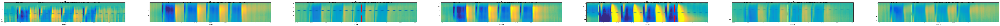

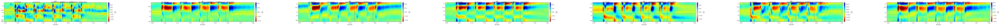

INFO:root:Plotted grand-averaged LFPs for condition go_gloexp


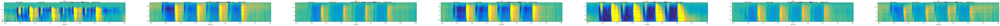

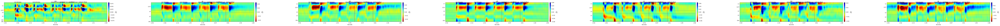

INFO:root:Plotted grand-averaged LFPs for condition go_seqctl


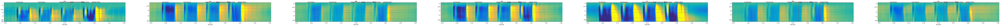

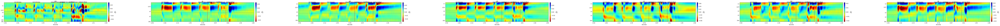

INFO:root:Plotted grand-averaged LFPs for condition lo_gloexp


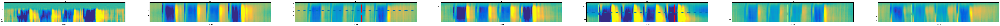

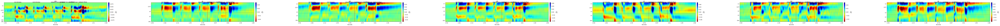

INFO:root:Plotted grand-averaged LFPs for condition lonaive


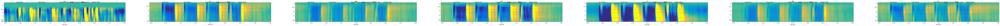

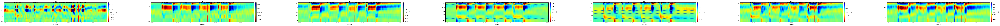

INFO:root:Plotted grand-averaged LFPs for condition lo_rndctl


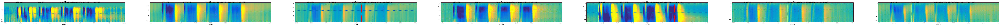

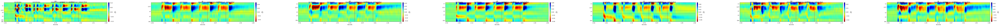

INFO:root:Plotted grand-averaged LFPs for condition igo_seqctl


In [14]:
for cond in CONDITIONS:
    avgs[cond].plot(vmin=-1e-1, vmax=1e-1, figure="mice_passiveglo_visual_%s_lfp.pdf" % cond, sigtitle=sigtitle, **events)
    csds[cond].plot(figure="mice_passiveglo_visual_%s_csd.pdf" % cond, cmap='jet_r', sigtitle=sigtitle, **events)
    logging.info("Plotted grand-averaged LFPs for condition %s" % cond)

In [15]:
subtraction_lfps, subtraction_csds = {}, {}

In [16]:
subtraction_events = {
    "Onset": (ODDBALL_ONSET.magnitude, 'lightgreen'),
    "Offset": (ODDBALL_OFFSET.magnitude, 'red'),
}

In [17]:
OFFSET = pq.Quantity(0.25) * pq.second

def subtract_signals(sig):
    subtraction = sig[(ODDBALL_ONSET - OFFSET).magnitude:(ODDBALL_OFFSET + OFFSET).magnitude] - sig[(ADAPTED_ONSET - OFFSET).magnitude:(ADAPTED_OFFSET + OFFSET).magnitude]
    return subtraction.shift_timestamps(-OFFSET)

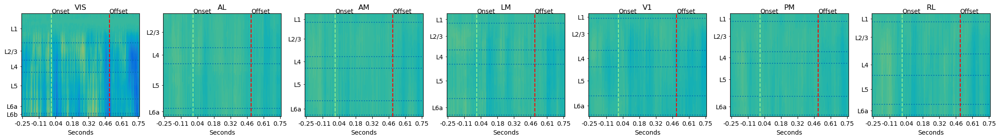

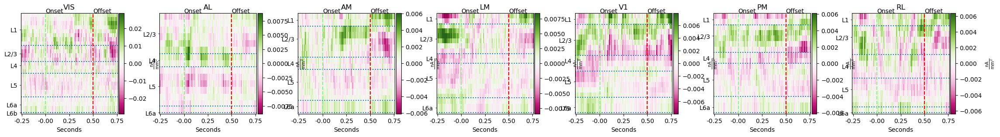

INFO:root:Plotted grand-averaged single subtractions for condition go_gloexp


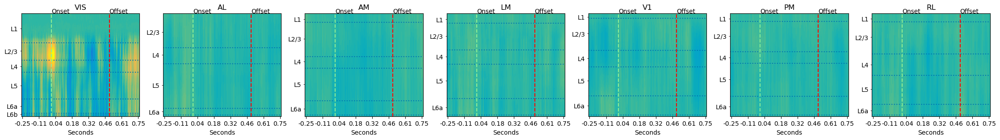

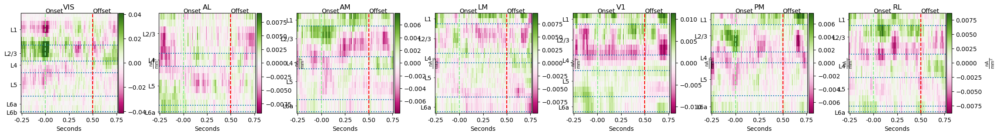

INFO:root:Plotted grand-averaged single subtractions for condition go_seqctl


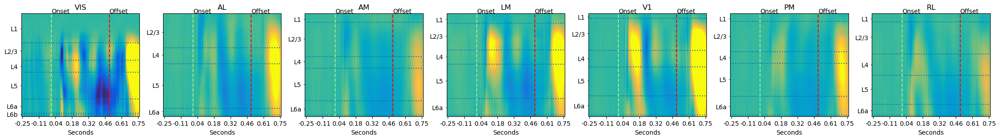

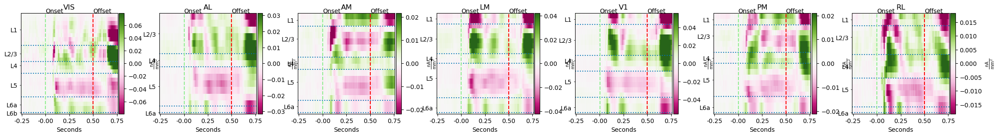

INFO:root:Plotted grand-averaged single subtractions for condition lo_gloexp


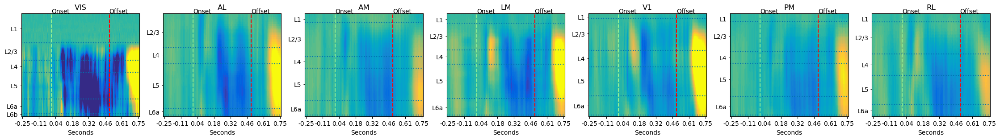

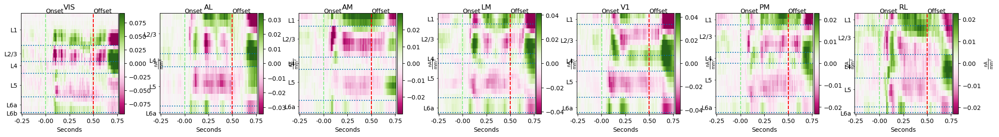

INFO:root:Plotted grand-averaged single subtractions for condition lonaive


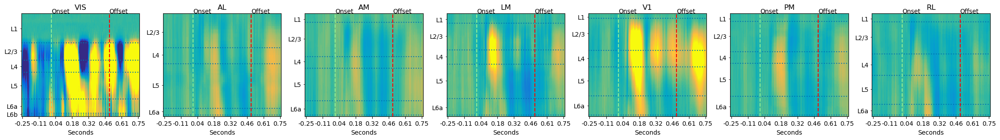

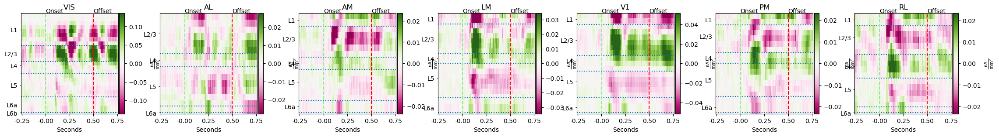

INFO:root:Plotted grand-averaged single subtractions for condition lo_rndctl


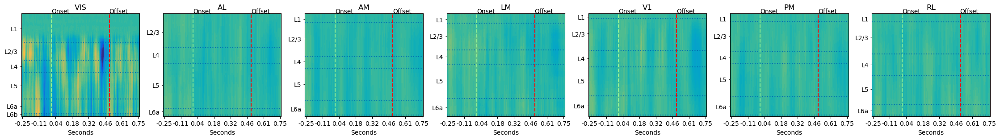

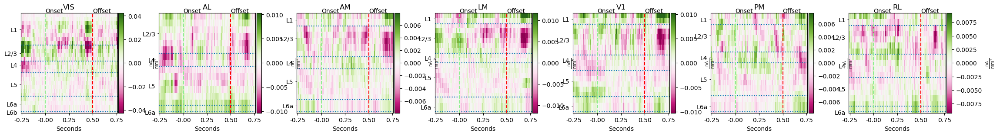

INFO:root:Plotted grand-averaged single subtractions for condition igo_seqctl


In [18]:
for cond in CONDITIONS:
    subtraction_lfps[cond] = avgs[cond].smap(subtract_signals)
    subtraction_lfps[cond].plot(vmin=-1e-1, vmax=1e-1, figure="mice_passiveglo_visual_4minus3_%s_lfp.pdf" % cond, sigtitle=sigtitle, **subtraction_events)

    subtraction_csds[cond] = csds[cond].smap(subtract_signals)
    subtraction_csds[cond].plot(figure="mice_passiveglo_visual_4minus3_%s_csd.pdf" % cond, cmap='PiYG', sigtitle=sigtitle, **subtraction_events)
    logging.info("Plotted grand-averaged single subtractions for condition %s" % cond)

In [19]:
CONTRASTS = [("logo", "lo_gloexp", "go_gloexp"), ("go_contrast", "go_gloexp", "go_seqctl"), ("lo_contrast", "lo_gloexp", "lo_rndctl"), ("ssa", "lo_gloexp", "igo_seqctl"), ("dd", "lo_rndctl", "lonaive")]

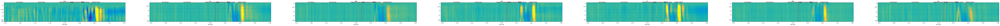

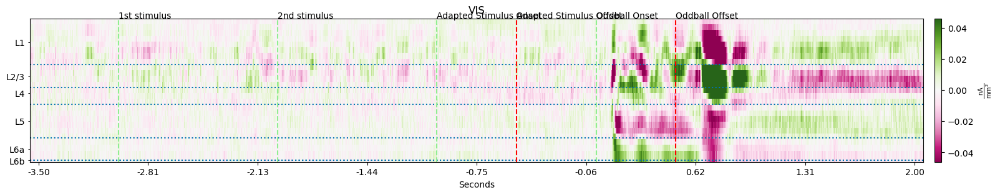

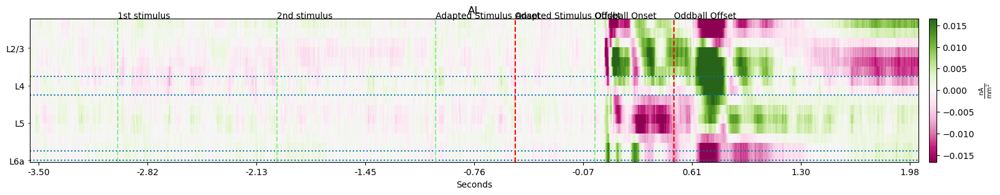

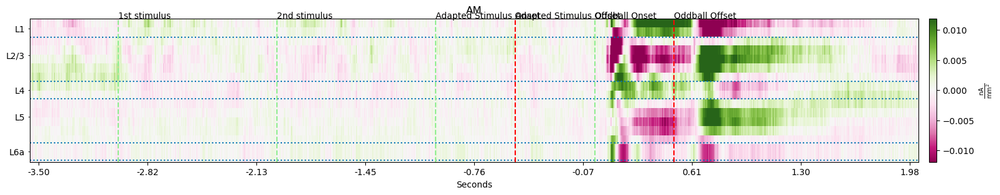

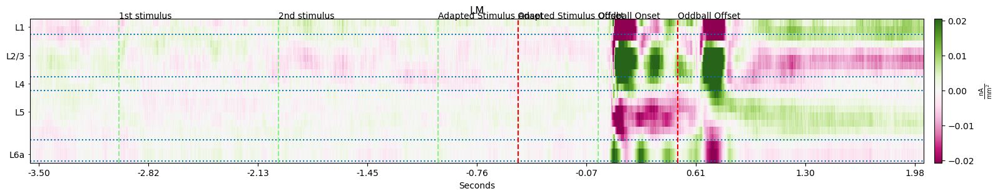

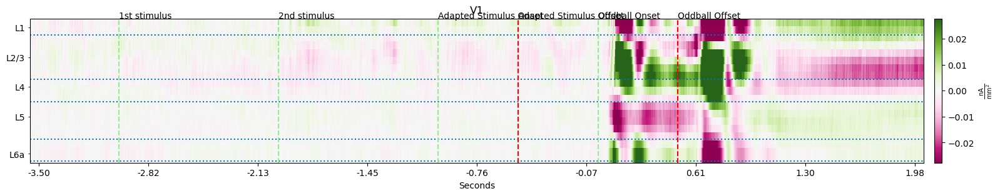

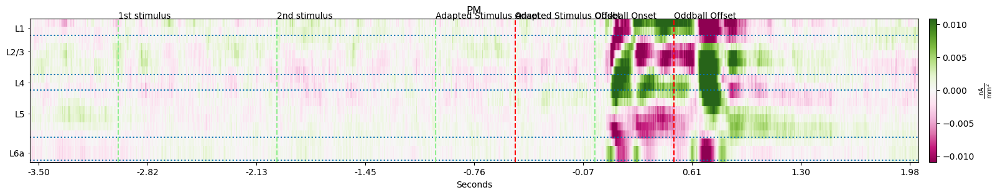

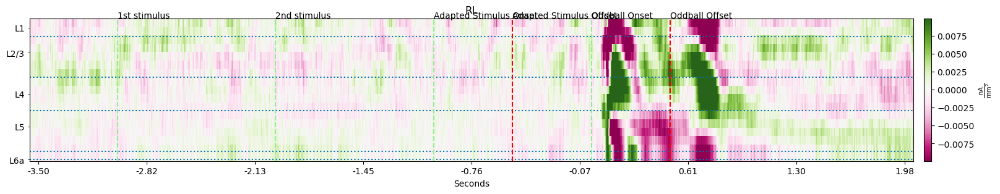

INFO:root:Plotted logo contrast


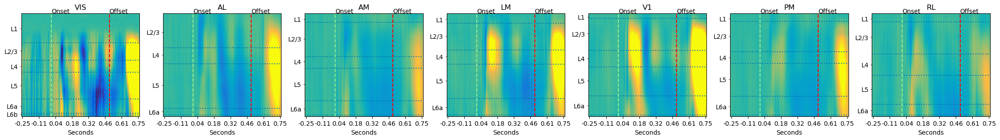

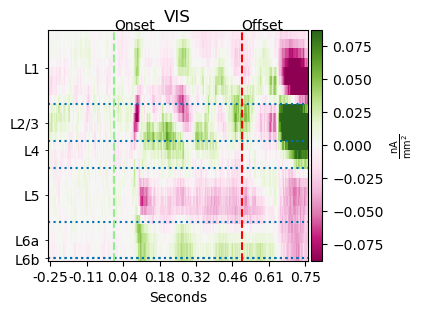

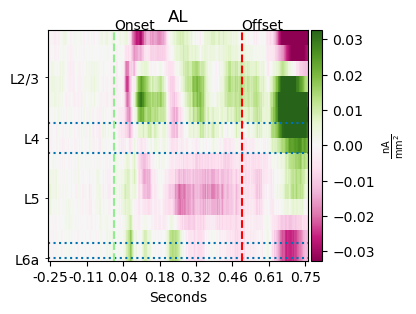

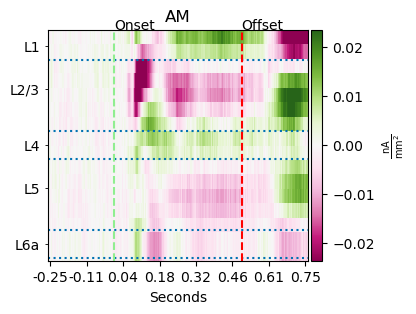

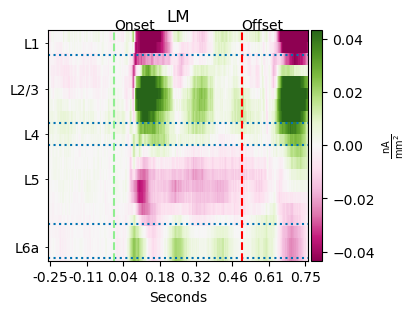

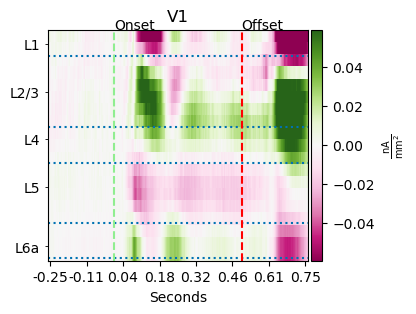

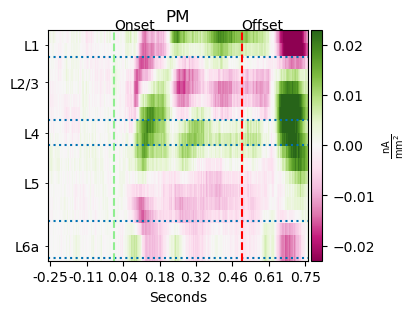

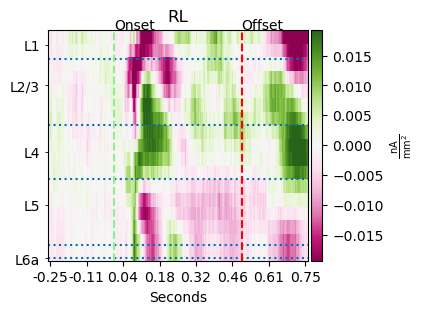

INFO:root:Plotted contrast of logo single subtractions


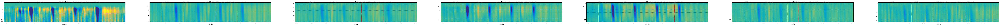

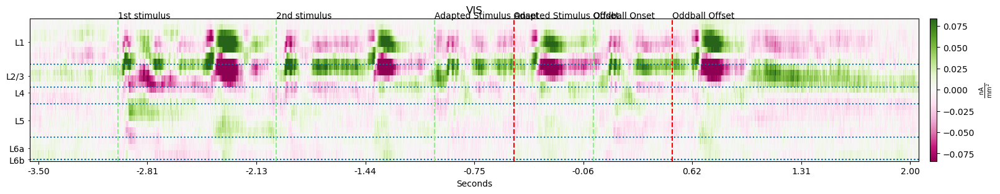

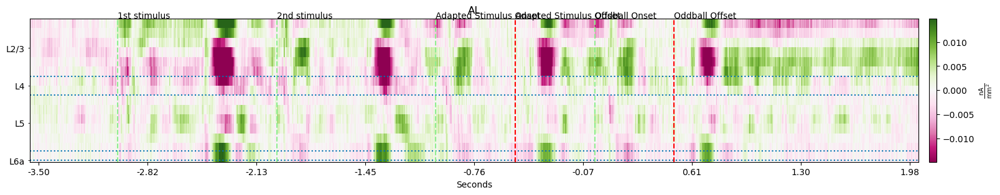

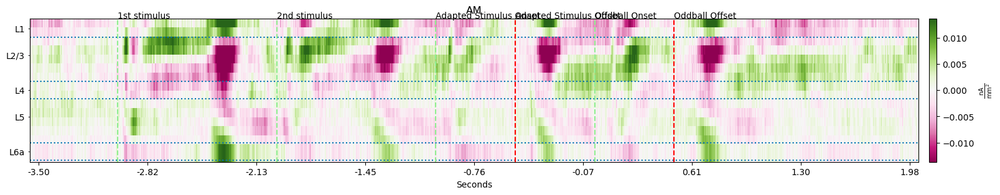

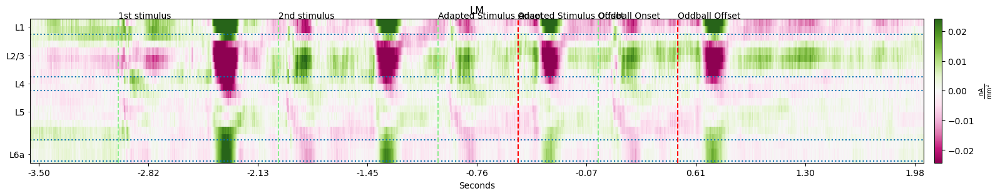

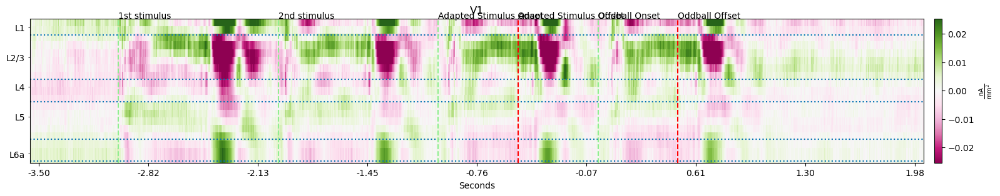

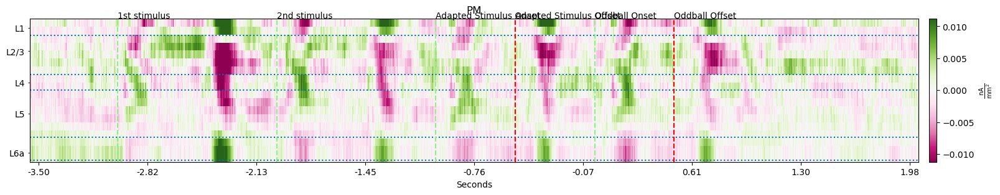

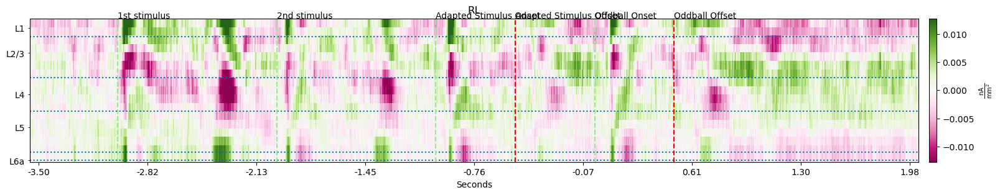

INFO:root:Plotted go_contrast contrast


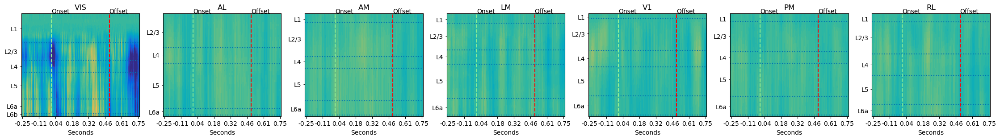

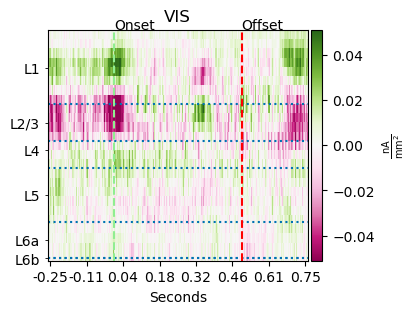

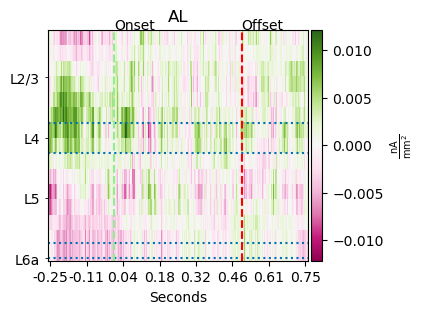

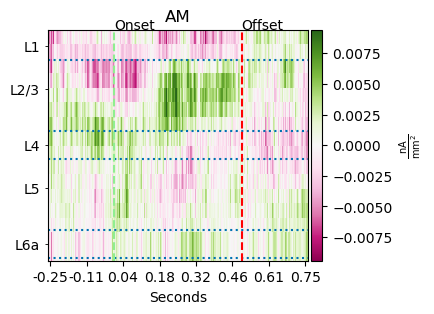

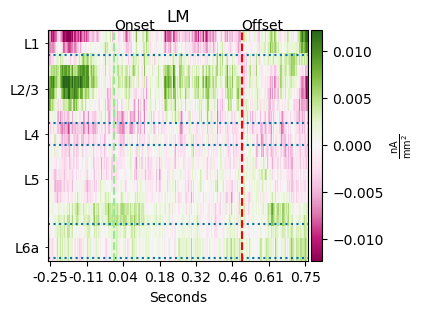

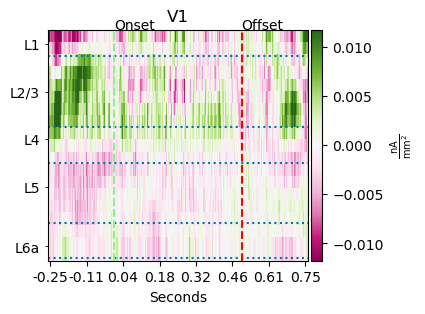

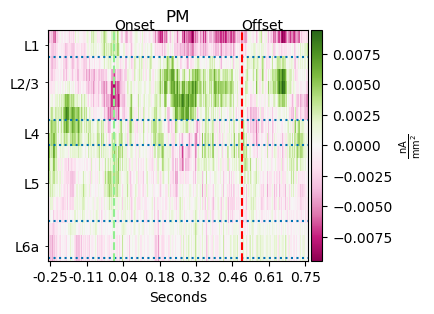

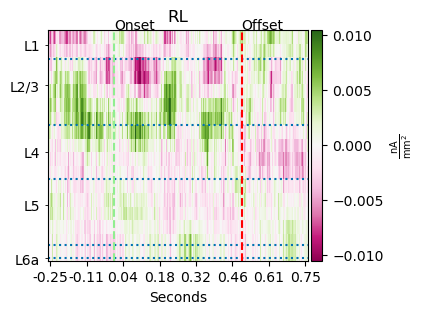

INFO:root:Plotted contrast of go_contrast single subtractions


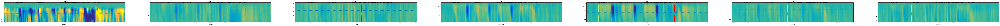

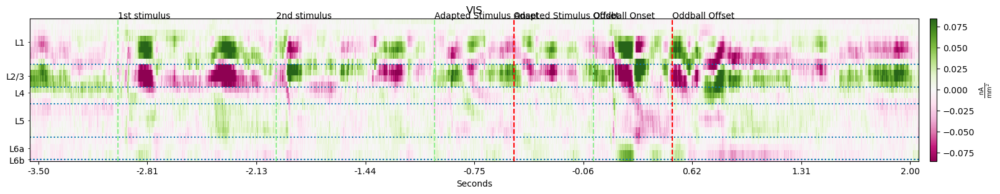

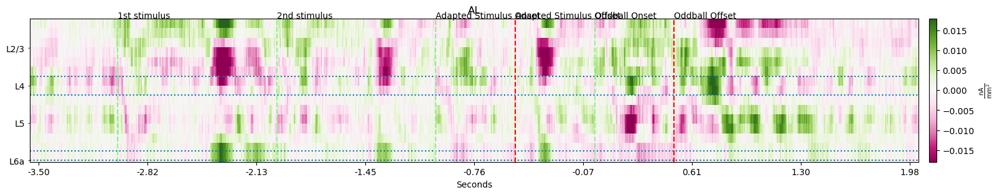

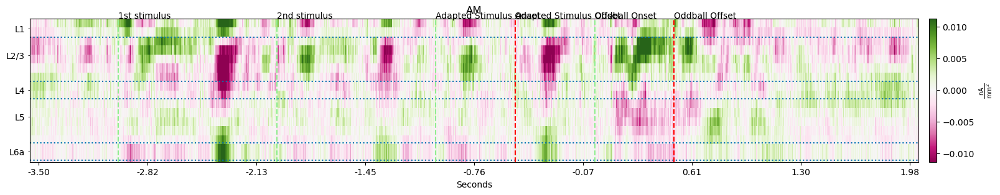

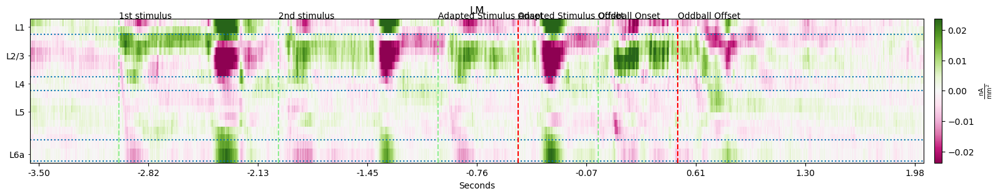

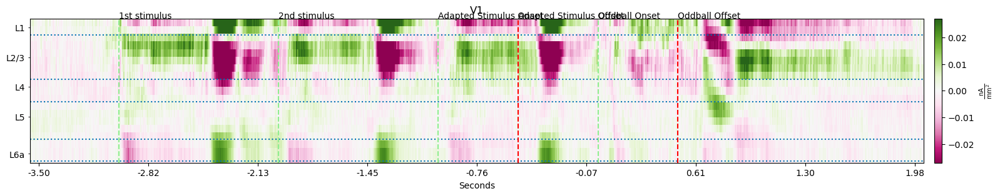

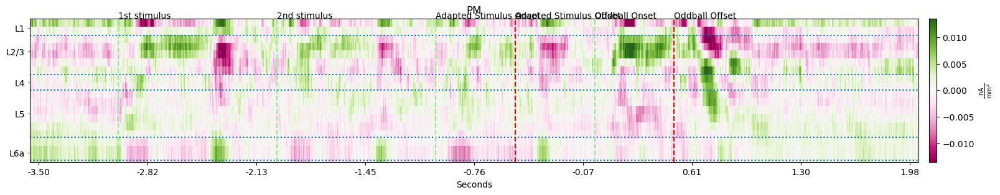

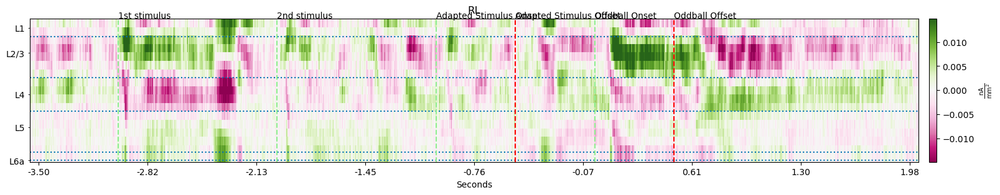

INFO:root:Plotted lo_contrast contrast


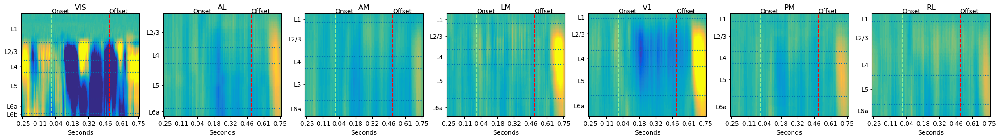

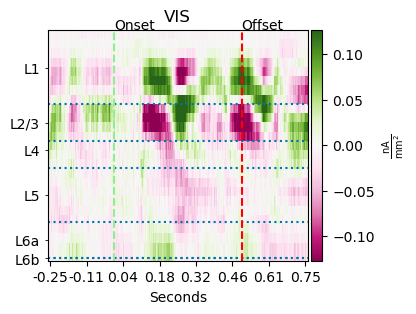

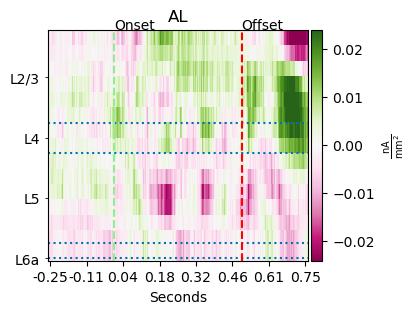

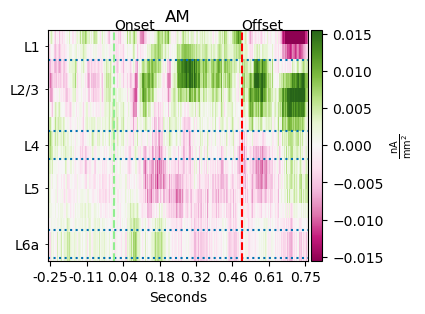

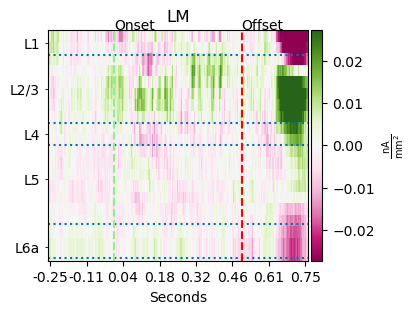

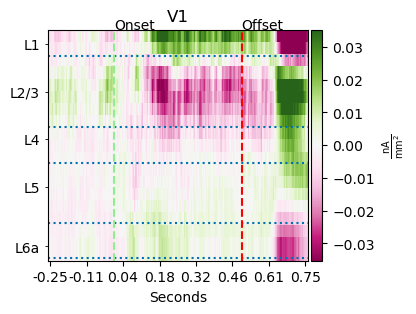

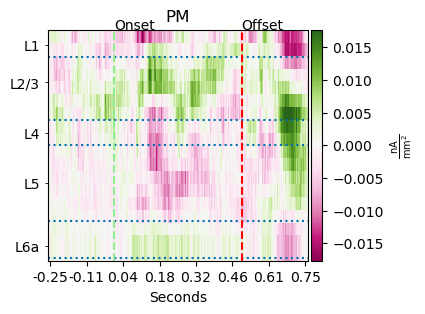

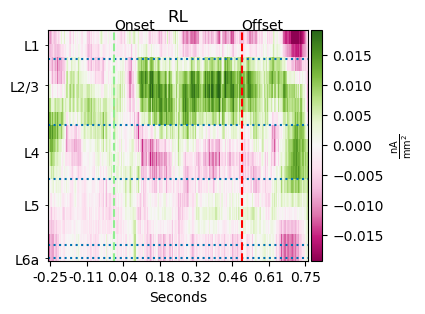

INFO:root:Plotted contrast of lo_contrast single subtractions


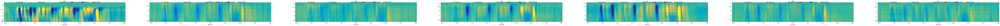

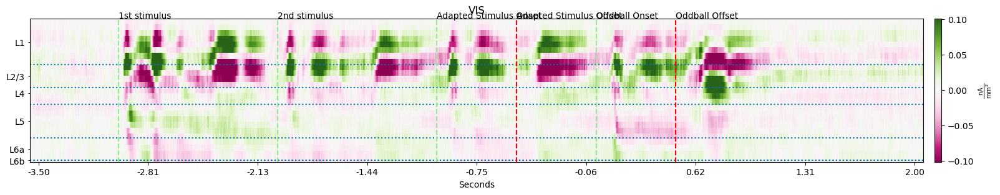

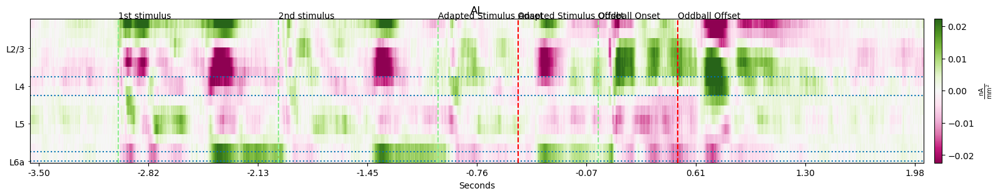

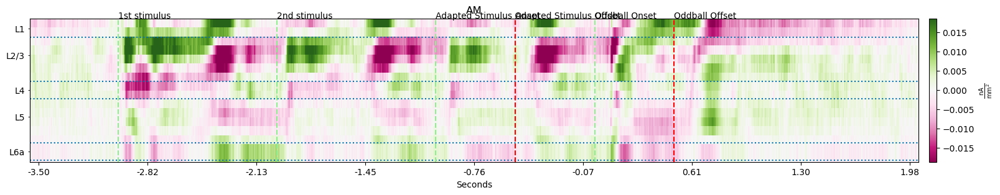

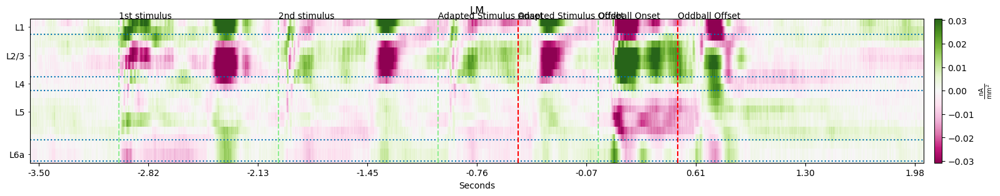

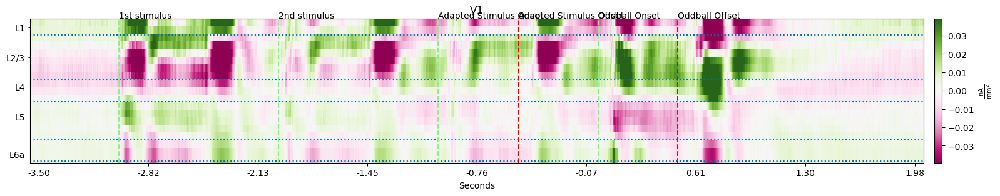

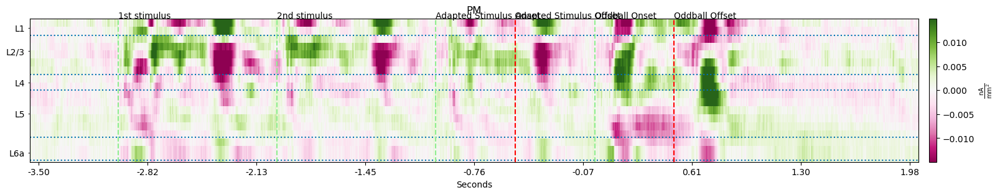

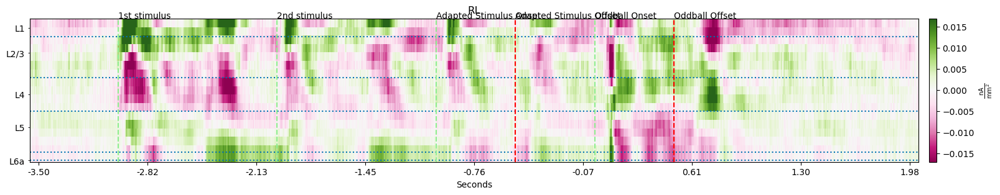

INFO:root:Plotted ssa contrast


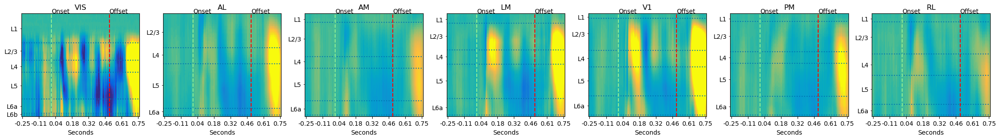

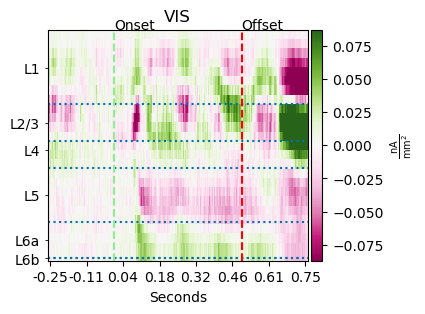

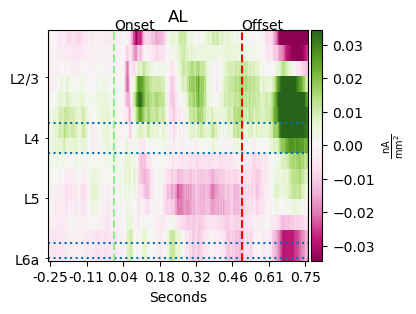

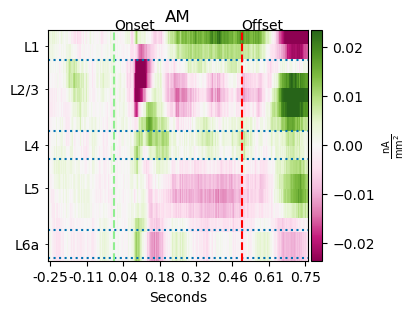

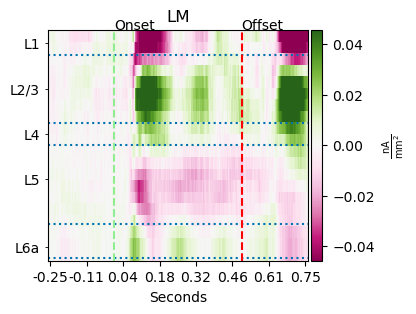

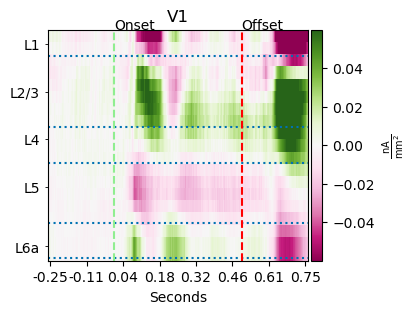

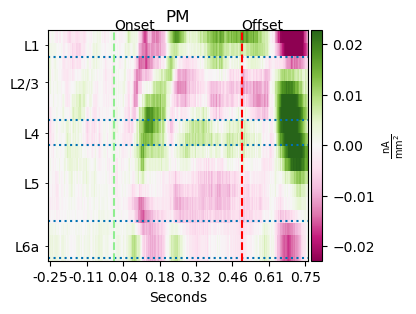

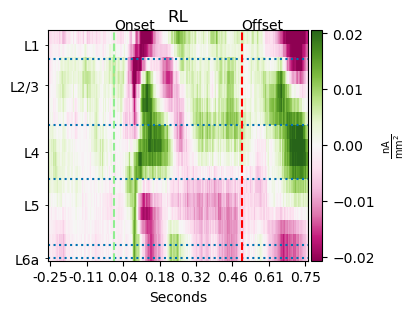

INFO:root:Plotted contrast of ssa single subtractions


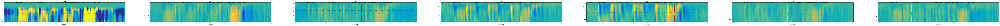

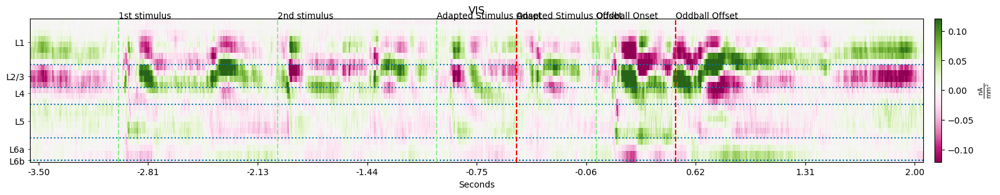

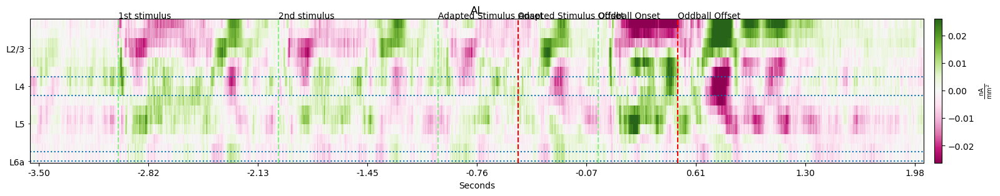

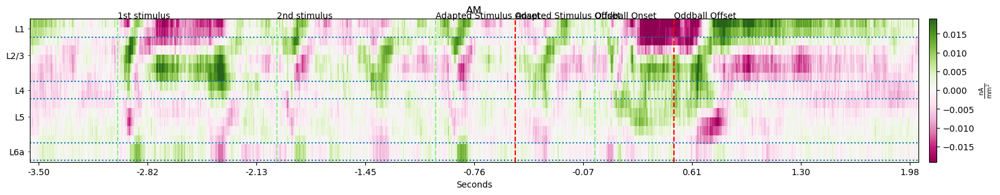

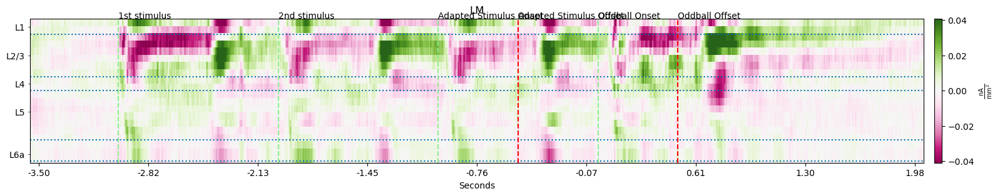

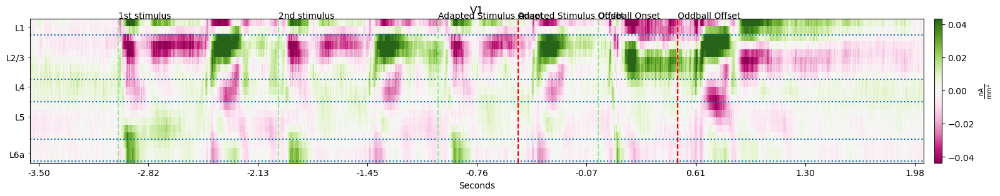

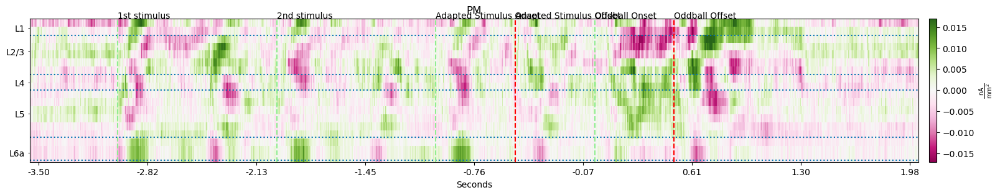

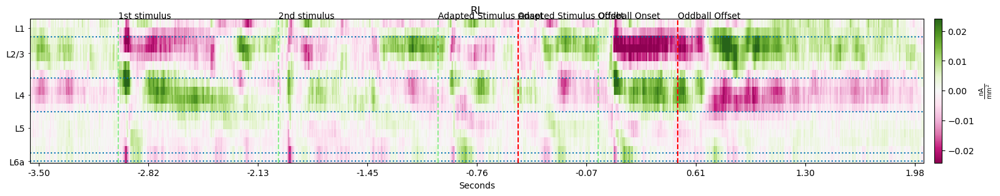

INFO:root:Plotted dd contrast


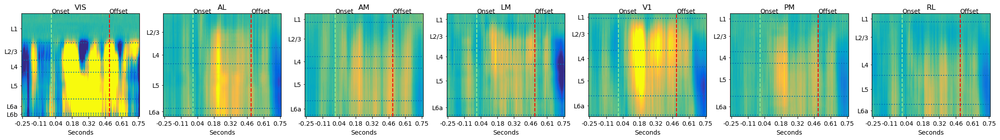

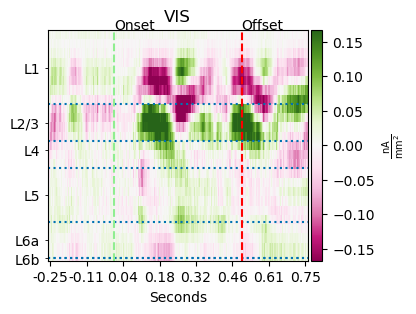

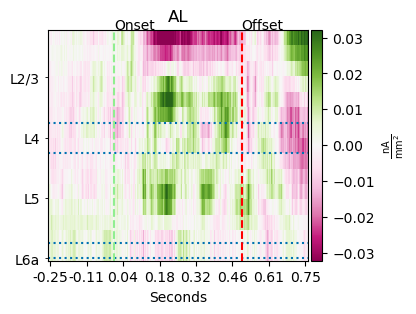

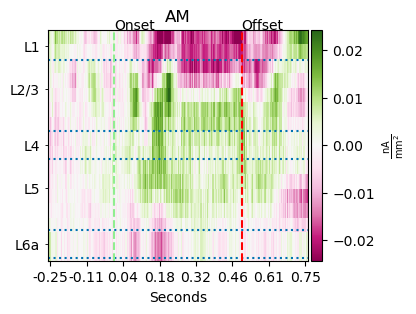

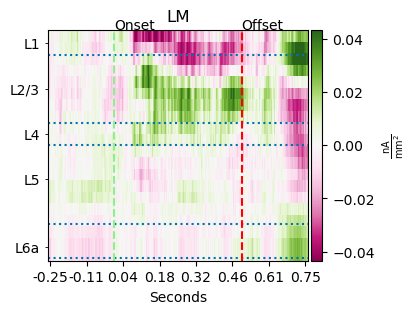

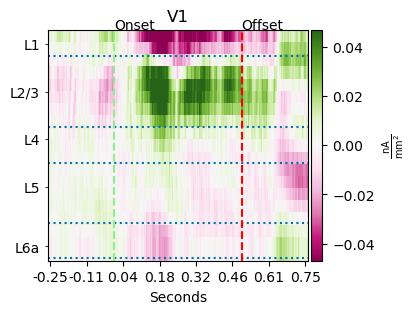

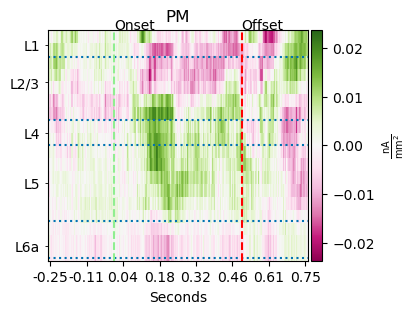

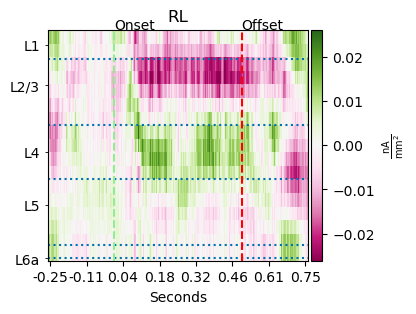

INFO:root:Plotted contrast of dd single subtractions


In [20]:
for (name, l, r) in CONTRASTS:
    lfp = avgs[l] - avgs[r]
    lfp.plot(vmin=-1e-1, vmax=1e-1, figure="mice_passiveglo_visual_%s_lfp.pdf" % name, sigtitle=sigtitle, **events)
    csd = csds[l] - csds[r]
    csd.plot_signals(name, cmap='PiYG', sigtitle=sigtitle, **events)
    logging.info("Plotted %s contrast" % name)

    lfp = subtraction_lfps[l] - subtraction_lfps[r]
    lfp.plot(vmin=-1e-1, vmax=1e-1, figure="mice_passiveglo_visual_4minus3_%s_lfp.pdf" % name, sigtitle=sigtitle, **subtraction_events)
    csd = subtraction_csds[l] - subtraction_csds[r]
    csd.plot_signals(name + "_4minus3", cmap='PiYG', sigtitle=sigtitle, **subtraction_events)
    logging.info("Plotted contrast of %s single subtractions" % name)